In [1]:
%cd ../..

C:\Users\ManuJoseph\OneDrive - Thoucentric\Work\Projects\Playground\AdvancedTimeSeriesForecastingBook\Github\Modern-Time-Series-Forecasting-with-Python-


In [2]:
import numpy as np
import pandas as pd
import plotly.express as px
from tqdm.autonotebook import tqdm
import os
from pathlib import Path
import random
import plotly.graph_objects as go
from plotly.subplots import make_subplots

C:\Users\ManuJoseph\AppData\Local\Temp\ipykernel_56256\2628223666.py:4: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm


In [3]:
os.makedirs("imgs/chapter_17", exist_ok=True)
preprocessed = Path("data/london_smart_meters/preprocessed")
output = Path("data/london_smart_meters/output")

In [4]:
from itertools import cycle
def format_plot(fig, legends=None, xlabel="Time", ylabel="Value", title="", font_size=15, fig_size=(900,500)):
    if legends:
        names = cycle(legends)
        fig.for_each_trace(lambda t: t.update(name=next(names)))
    fig.update_layout(
        autosize=False,
        width=fig_size[0],
        height=fig_size[1],
        title_text=title,
        title={"x": 0.5, "xanchor": "center", "yanchor": "top"},
        titlefont={"size": 20},
        legend_title=None,
        legend=dict(
            font=dict(size=font_size),
            orientation="h",
            yanchor="bottom",
            y=0.9,
            xanchor="right",
            x=1,
        ),
        yaxis=dict(
            title_text=ylabel,
            titlefont=dict(size=font_size),
            tickfont=dict(size=font_size),
        ),
        xaxis=dict(
            title_text=xlabel,
            titlefont=dict(size=font_size),
            tickfont=dict(size=font_size),
        )
    )
    return fig

## Over and Under Forecasting

In [21]:
def clean_inf(array):
    array[np.isinf(array)] = np.nan
    return array

In [24]:
#MAPE
def calc_mape(df, fc_col, ac_col):
    a = df[ac_col].values
    f = df[fc_col].values
    abs_err = np.abs(a-f)
    ape = abs_err/a
    return np.mean(ape)

#WAPE
def calc_wape(df, fc_col, ac_col):
    a = df[ac_col].values
    f = df[fc_col].values
    abs_err = np.abs(a-f)
    return np.sum(abs_err)/np.sum(np.abs(a))

#sMAPE
def calc_smape(df, fc_col, ac_col):
    a = df[ac_col].values
    f = df[fc_col].values
    abs_err = np.abs(a-f)
    ape = 2*abs_err/(a+f)
    return np.mean(ape)

#MAE
def calc_mae(df, fc_col, ac_col):
    a = df[ac_col].values
    f = df[fc_col].values
    abs_err = np.abs(a-f)
    return np.mean(abs_err)

#RMSE
def calc_rmse(df, fc_col, ac_col):
    a = df[ac_col].values
    f = df[fc_col].values
    sq_err = np.power(np.abs(a-f),2)
    return np.sqrt(np.mean(sq_err))

#MRAE
def calc_mrae(df, fc_col, ac_col):
    a = df[ac_col].values[1:]
    f = df[fc_col].values[1:]
    f_star = df[ac_col].shift(1).values[1:]
    abs_err = np.abs(a-f)
    ape = clean_inf(abs_err/np.abs((a-f_star)))
    return np.nanmean(ape)

#MdRAE
def calc_mdrae(df, fc_col, ac_col):
    a = df[ac_col].values[1:]
    f = df[fc_col].values[1:]
    f_star = df[ac_col].shift(1).values[1:]
    abs_err = np.abs(a-f)
    ape = clean_inf(abs_err/np.abs((a-f_star)))
    return np.nanmedian(ape)

#MASE
def calc_mase(df, fc_col, ac_col):
    a = df[ac_col].values[1:]
    f = df[fc_col].values[1:]
    f_star = df[ac_col].shift(1).values[1:]
    abs_err = np.abs(a-f)
    ape = abs_err/np.mean(np.abs(a-f_star))
    return np.mean(ape)

# RMSSE
def calc_rmsse(df, fc_col, ac_col):
    a = df[ac_col].values[1:]
    f = df[fc_col].values[1:]
    f_star = df[ac_col].shift(1).values[1:]
    sq_err = np.square(a-f)
    scale = np.mean(np.square(a-f_star))
    return np.sqrt(np.mean(sq_err/scale))

#RelMAE
def calc_rmae(df, fc_col, ac_col):
    a = df[ac_col].values[1:]
    f = df[fc_col].values[1:]
    f_star = df[ac_col].shift(1).values[1:]
    abs_err = np.abs(a-f)
    abs_err_star = np.abs(a-f_star)
    return np.mean(abs_err)/np.mean(abs_err_star)

#RelRMSE
def calc_rrmse(df, fc_col, ac_col):
    a = df[ac_col].values[1:]
    f = df[fc_col].values[1:]
    f_star = df[ac_col].shift(1).values[1:]
    sq_err = np.square(a-f)
    sq_err_star = np.square(a-f_star)
    return np.sqrt(np.mean(sq_err))/np.sqrt(np.mean(sq_err_star))

#RelMAPE
def calc_rmape(df, fc_col, ac_col):
    a = df[ac_col].values[1:]
    f = df[fc_col].values[1:]
    f_star = df[ac_col].shift(1).values[1:]
    perc_err = np.abs(a-f)/a
    perc_err_star = np.abs(a-f_star)/a
    return np.mean(perc_err)/np.mean(perc_err_star)

def experiment(n, calc):
    sample_df = pd.DataFrame({
        "time":np.arange(n),
        "actuals": np.random.randint(2,5,n),
        "forecast_baseline": np.random.randint(2,5,n),
        "forecast_low": np.random.randint(0,4,n),
        "forecast_high": np.random.randint(3,7,n),
    })
    baseline = calc(sample_df, fc_col="forecast_baseline", ac_col="actuals")
    low = calc(sample_df, fc_col="forecast_low", ac_col="actuals")
    high = calc(sample_df, fc_col="forecast_high", ac_col="actuals")
    return baseline, low, high

In [25]:
results = []
fns = {
    "MAPE": calc_mape,
    "WAPE": calc_wape,
    "SMAPE": calc_smape,
    "MAE": calc_mae,
    "RMSE": calc_rmse,
    "MASE": calc_mase,
    "RMSSE": calc_rmsse,
    "MRAE": calc_mrae,
    "RelMAE": calc_rmae,
    "RelRMSE": calc_rrmse,
    "RelMAPE": calc_rmape
}
for i in tqdm(range(10000), total=10000):
    res_dict = dict()
    for metric, fn in fns.items():
        res_dict[metric], res_dict[f"{metric}(U)"], res_dict[f"{metric}(O)"]  = experiment(100, fn)
    results.append(res_dict)

results_df = pd.DataFrame(results)
results_df.head()

  0%|          | 0/10000 [00:00<?, ?it/s]

C:\Users\ManuJoseph\AppData\Local\Temp\ipykernel_56256\3591116957.py:44: RuntimeWarning:

divide by zero encountered in true_divide

C:\Users\ManuJoseph\AppData\Local\Temp\ipykernel_56256\3591116957.py:44: RuntimeWarning:

invalid value encountered in true_divide



,MAPE,MAPE(U),MAPE(O),WAPE,WAPE(U),WAPE(O),SMAPE,SMAPE(U),SMAPE(O),MAE,...,MRAE(O),RelMAE,RelMAE(U),RelMAE(O),RelRMSE,RelRMSE(U),RelRMSE(O),RelMAPE,RelMAPE(U),RelMAPE(O)
0,0.353333,0.535000,0.645000,0.250000,0.586667,0.550000,0.313905,0.916857,0.434873,0.73,...,1.519231,0.930233,1.825581,2.046512,0.905822,1.583165,1.613246,0.912037,1.483796,1.891204
1,0.341667,0.556667,0.677500,0.238095,0.606349,0.473016,0.328190,0.851048,0.452873,0.96,...,1.274648,1.210526,1.828947,2.078947,1.007663,1.691608,1.903438,0.891403,1.493213,1.748869
2,0.307500,0.540000,0.583333,0.289562,0.579125,0.595960,0.304381,0.928762,0.419397,0.86,...,1.411765,1.036145,1.927711,2.168675,0.902378,1.673320,1.808709,0.988610,1.384966,1.963554
3,0.305000,0.513333,0.679167,0.260274,0.469178,0.565068,0.334476,0.943333,0.463476,0.76,...,1.301370,1.066667,1.922222,1.911111,0.945484,1.785887,1.660595,1.177596,1.844262,2.079235
4,0.305000,0.530833,0.628333,0.273026,0.549342,0.592105,0.320190,0.869714,0.497175,1.03,...,1.500000,1.116883,2.155844,2.116883,0.826965,1.563701,1.472325,0.761124,1.327869,1.730679


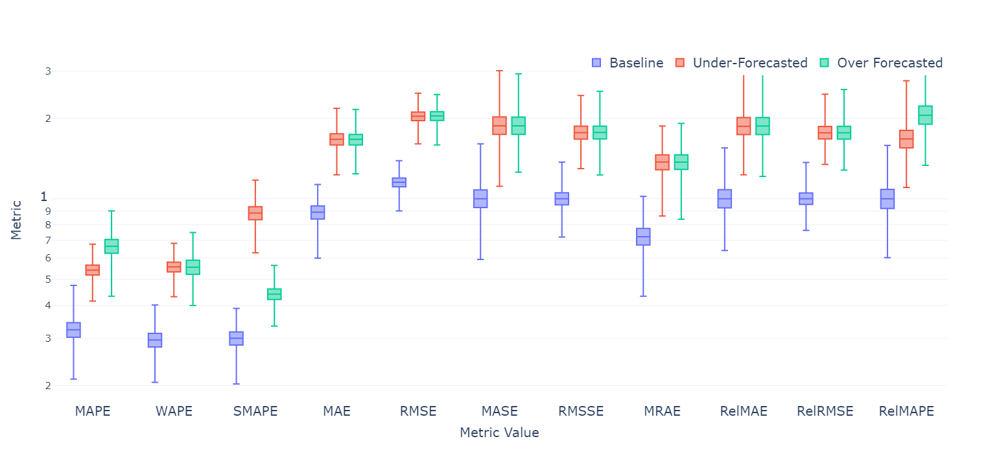

In [26]:
plot_df = pd.melt(results_df, var_name="Metric", value_name="Value")
plot_df['Type'] = "B"
plot_df.loc[plot_df.Metric.str.endswith("(U)"), "Type"] = "U"
plot_df.loc[plot_df.Metric.str.endswith("(O)"), "Type"] = "O"
plot_df.Metric = plot_df.Metric.apply(lambda x: x.replace("(U)","").replace("(O)","").strip())
fig = px.box(plot_df, y="Value", x="Metric", color="Type", template="plotly_white", points=False, log_y=True)
fig = format_plot(fig, legends=["Baseline", "Under-Forecasted", "Over Forecasted"], xlabel="Metric Value", ylabel="Metric", fig_size=(1200, 700), font_size=20)
fig.write_image(f"imgs/chapter_17/over_under_fc.png")
fig.show()

In [11]:
from plotly.colors import n_colors
greys_all = n_colors('rgb(0, 0, 0)', 'rgb(255, 255, 255)', 4, colortype='rgb')
greys_dark = n_colors('rgb(0, 0, 0)', 'rgb(200, 200, 200)', 4, colortype='rgb')
greys_light = n_colors('rgb(200, 200, 200)', 'rgb(255, 255, 255)', 4, colortype='rgb')
greys = n_colors('rgb(100, 100, 100)', 'rgb(255, 255, 255)', 4, colortype='rgb')

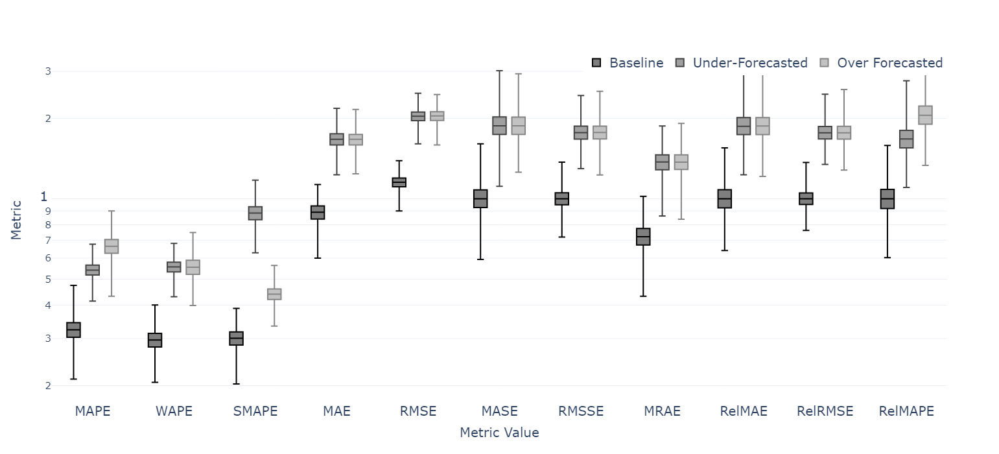

In [27]:
fig = px.box(plot_df, y="Value", x="Metric", color="Type", template="plotly_white", points=False, color_discrete_sequence=greys_dark, log_y=True)
fig = format_plot(fig, legends=["Baseline", "Under-Forecasted", "Over Forecasted"], xlabel="Metric Value", ylabel="Metric", fig_size=(1200, 700), font_size=20)
fig.write_image(f"imgs/chapter_17/over_under_fc_grayscale.png")
fig.show()